In [12]:
import cellPLATO as cp

import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt



OVERWRITE_DATAFRAMES = False

In [13]:
# Get the experiment list from the experiments listed in the config 
exp_list = cp.populate_experiment_list()
display(exp_list)

,Condition,Experiment,Replicate_ID,Condition_shortlabel,Replicate_shortlabel
0,Condition_PBMCeNK_20x,PBMCeNK_untreated_1__tracks,PBMCeNK_untreated_1__tracks,eNKs,eNKs_0
1,Condition_PBMCeNK_20x,PBMCeNK_untreated_2__tracks,PBMCeNK_untreated_2__tracks,eNKs,eNKs_1
2,Condition_PBMCeNK_20x_cytoD,PBMCeNK_CytoD_2_tracks,PBMCeNK_CytoD_2_tracks,eNKs CytoD,eNKs CytoD_0


## Load dataframes

In [14]:
if os.path.exists(cp.SAVED_DATA_PATH + 'dr_df.csv'):
    print(cp.SAVED_DATA_PATH + 'dr_df_.csv',' exists, loading dataframes...')
    
    # Load existing (preprocessed) data
    comb_df = pd.read_csv(cp.SAVED_DATA_PATH + 'comb_df.csv')
    dr_df = pd.read_csv(cp.SAVED_DATA_PATH + 'dr_df.csv')
    lab_dr_df = pd.read_csv(cp.SAVED_DATA_PATH + 'lab_dr_df.csv')
    tavg_df = pd.read_csv(cp.SAVED_DATA_PATH + 'tavg_df.csv')
else:
    
    print('File doesnt exist.')

D:/Michael_Shannon/CELLPLATO_MASTER/FIGURE_1_ALT_OUTPUT/Fig1_PBMCderivedeNKsICAM_10_4_2022\saved_data/dr_df_.csv  exists, loading dataframes...


### Filter upstream of dimensionality reduction

Applying filters:
{'area': (10, 10000), 'ntpts': (12, 1800)}
Beginning filtering ...
99603  data points from  1765  cells
Applying filters to entire cell trajectory:
{'area': (10, 10000), 'ntpts': (12, 1800)}
...
 Finished filtering. Resulting dataframe contains:
99603  data points from  1765  cells


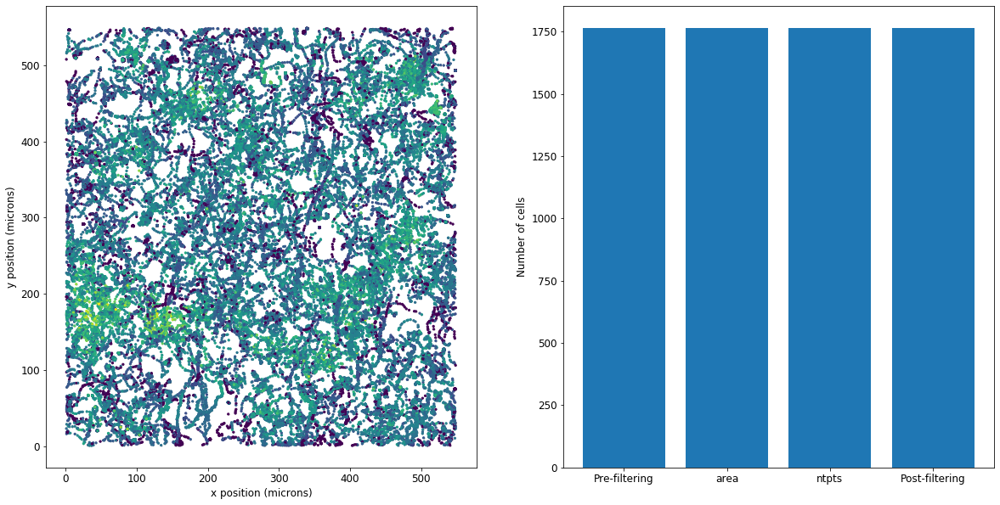

In [15]:
# User-defined filters in dict {factor:(min, max)}
data_filters = {
#   "speed": (10, 100),
   "area": (10, 10000), # Warning: range will change if self-normalized
  "ntpts": (12,1800)
}

# Returns a filtered dataframe, while also adding included column to comb_df
filt_df, filt_counts = cp.apply_filters(comb_df,filter_dict=data_filters)

fig = cp.visualize_filtering(comb_df, filt_counts)

In [ ]:
comb_df = filt_df #Apply that filtering to the comb_df

## Dimensionality Reduction (DR)

In [16]:
# Before running dr_pipeline, check if the file already exists in the local namespace
if 'dr_df' in locals():
    
    print('Using loaded dr_df')
    
else: 

    dr_df = cp.dr_pipeline(comb_df, dr_factors=cp.DR_FACTORS) 

Using loaded dr_df


### DR: first check automatic selection of cluster parameters

['eNKs' 'eNKs CytoD']


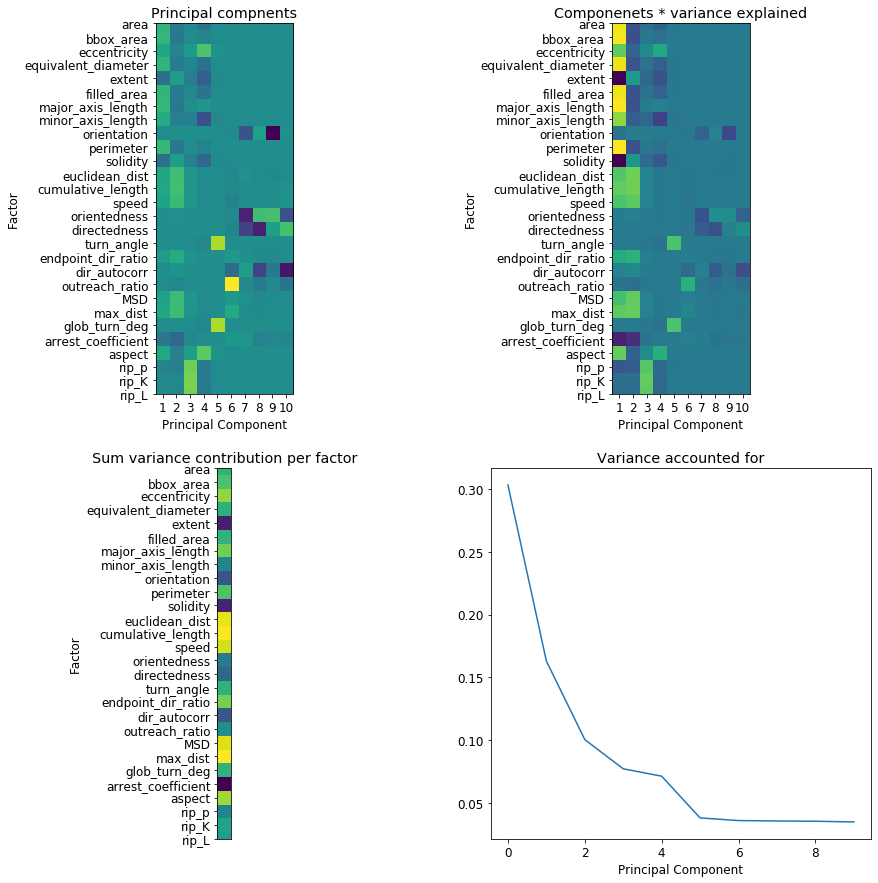

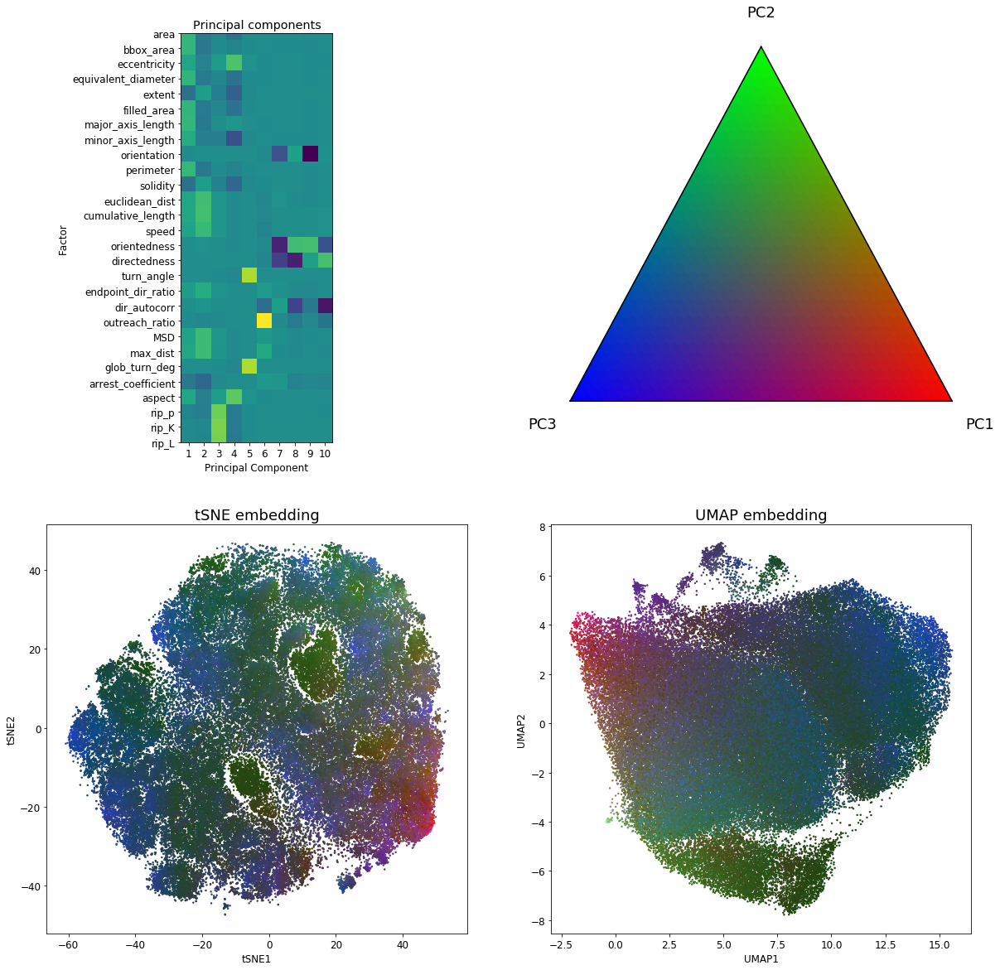

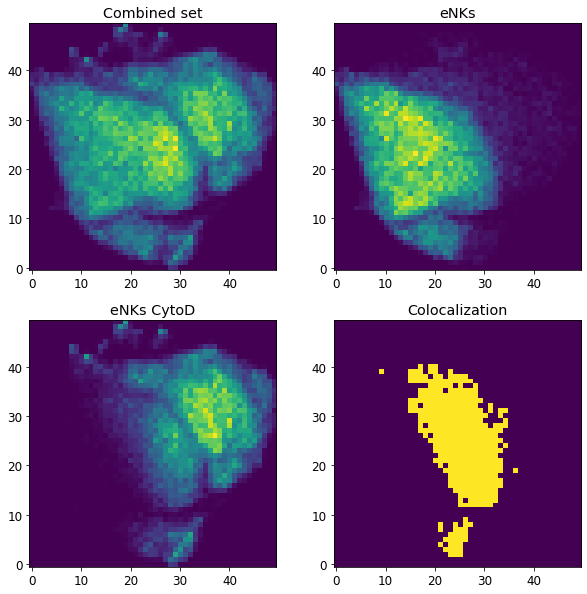

In [18]:
pca_df, components, expl = cp.do_pca(comb_df[cp.DR_FACTORS])
f = cp.pca_factor_vis(dr_df,pca_tuple=[pca_df, components, expl])#cp.DR_FACTORS)
f = cp.dimension_reduction_subplots(dr_df,pca_tuple=[pca_df, components, expl])
f = cp.spatial_img_coloc(dr_df, xy='umap',thresh=10,n_bins=50)

### DR: sweep to check for best parameters for clustering: THIS ONE ALLOWS YOU TO SWEEP BOTH PERP, UMAP_NN, and EPS.

In [ ]:
# Simultaneously sweep a range of critical parameters for tSNE and UMAP embeddings.
epsyo = [0.023,0.025]

# UMAP_MIN_DIST = 0.1

# min_dist = 0.1

cp.sweep_tsne_umap(comb_df, 
                perp_min_max=(100,185), 
                nn_min_max=(10,50),
                n_vals=1,
                nested_dbscan_sweep=False,  
                dr_factors=cp.DR_FACTORS, 
                eps_vals=epsyo) #cp.EPS


### DR: After the above, redo the dimensionality reduction with chosen params and save to in the local space

Running dr_pipeline...
tSNE perplexity =  185
UMAP nearest neighbors =  50  min distance =  0.2
Using standardized factors for dimensionality reduction, matrix shape:  (99603, 28)
Using openTSNE with perplexity =  185
Using openTSNE to calculate new embedding for input data.
Embedding shape:  (99603, 2)
['eNKs' 'eNKs CytoD']


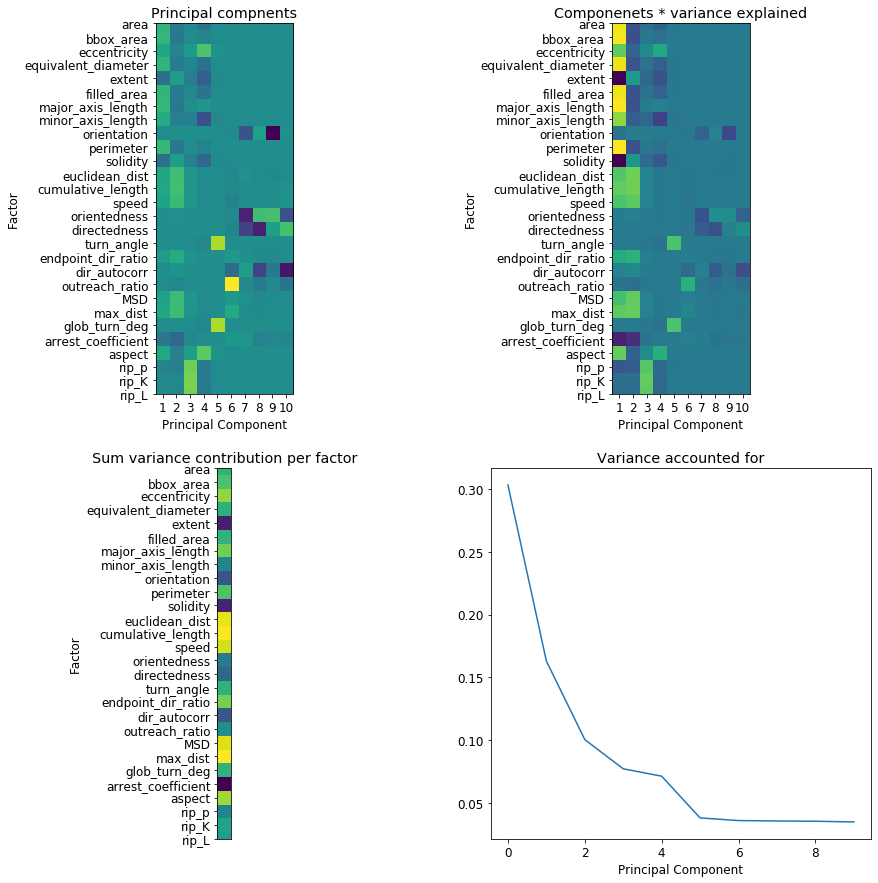

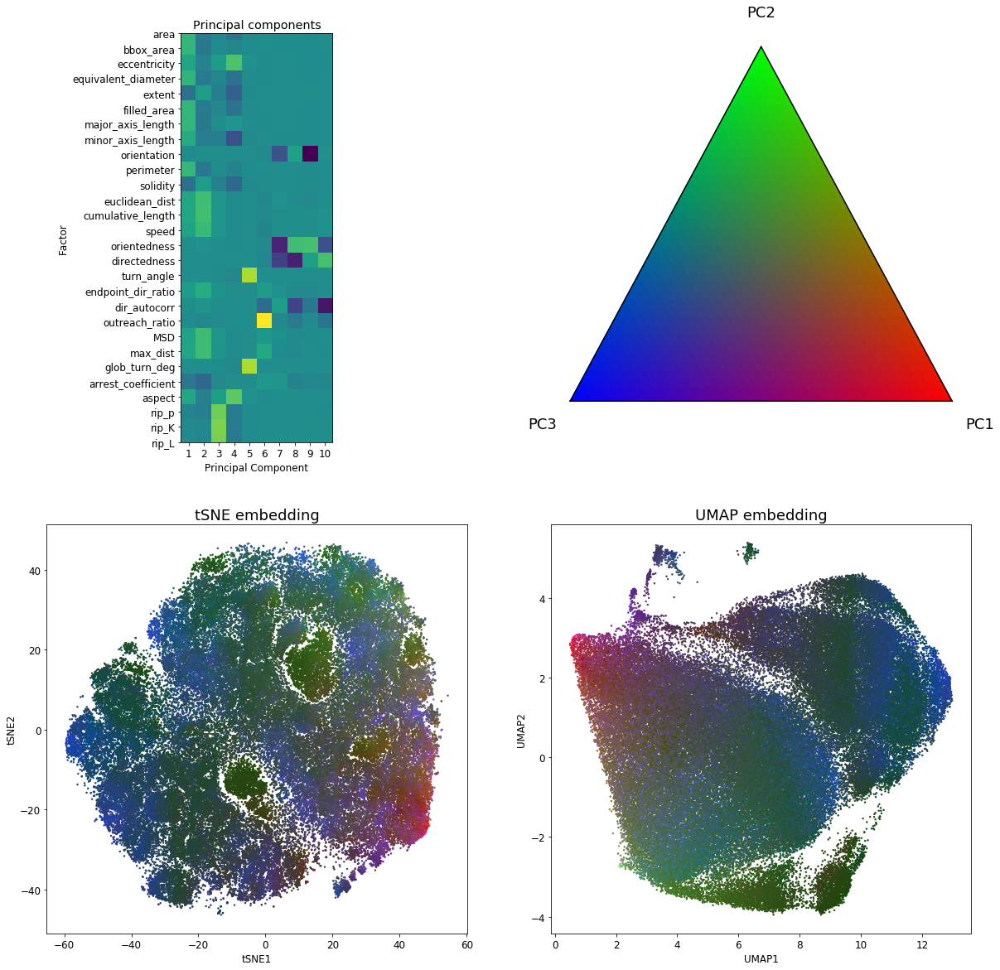

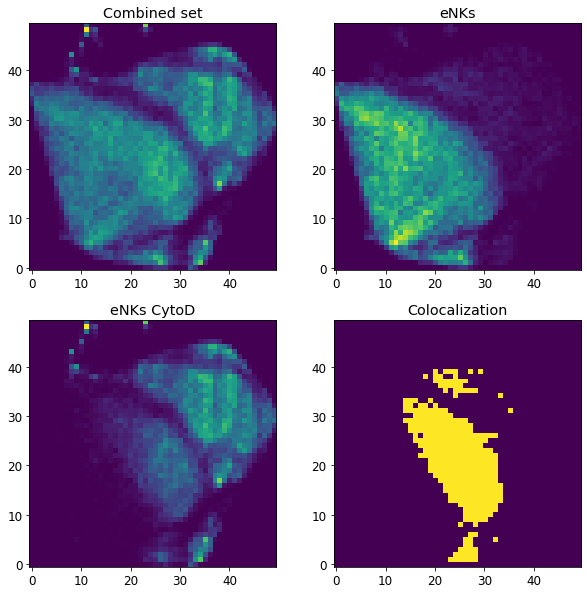

In [21]:
# Now re-do the dimensionality reduction with selected parameters:

# Replace these values with the ones found from the previous sweep
perplexity= 185
umap_nn= 50
min_dist= 0.2

# perplexity = cp.TSNE_PERP #Defaults from config
# umap_nn = cp.UMAP_NN
# min_dist = cp.UMAP_MIN_DIST

pca_df, components, expl = cp.do_pca(comb_df[cp.DR_FACTORS])

dr_df = cp.dr_pipeline(comb_df, 
                    dr_factors=cp.DR_FACTORS,
                    tsne_perp=perplexity,
                    umap_nn=umap_nn,
                    min_dist=min_dist) 

f = cp.pca_factor_vis(dr_df,pca_tuple=[pca_df, components, expl])#cp.DR_FACTORS)
f = cp.dimension_reduction_subplots(dr_df,pca_tuple=[pca_df, components, expl])
f = cp.spatial_img_coloc(dr_df, xy='umap',thresh=10,n_bins=50)

### DR: sweep to check for best parameters for clustering: THIS ONE just for EPS, on already set tsne or UMAP values

dbscan_clustering() with eps =  0.023
DBScan clustering by UMAP...
Clustering generated: 169 subgoups.
eps:  0.023  clusters:  169
dbscan_clustering() with eps =  0.025
DBScan clustering by UMAP...
Clustering generated: 113 subgoups.
eps:  0.025  clusters:  113
dbscan_clustering() with eps =  0.023
DBScan clustering by tSNE...
Clustering generated: 208 subgoups.
eps:  0.023  clusters:  208
dbscan_clustering() with eps =  0.025
DBScan clustering by tSNE...
Clustering generated: 132 subgoups.
eps:  0.025  clusters:  132
Failed to draw cluster, failed to draw cluster:  95  with shape:  (21, 2)
Failed to draw cluster, failed to draw cluster:  95  with shape:  (21, 2)
Failed to draw cluster, failed to draw cluster:  95  with shape:  (21, 2)
Finished sweeping dbscan clustering. See output directory:  D:/Michael_Shannon/CELLPLATO_MASTER/FIGURE_1_ALT_OUTPUT/Fig1_PBMCderivedeNKsICAM_10_4_2022\2022-10-04_16-56-07-919770\plots/Clustering/Parameter_sweep/


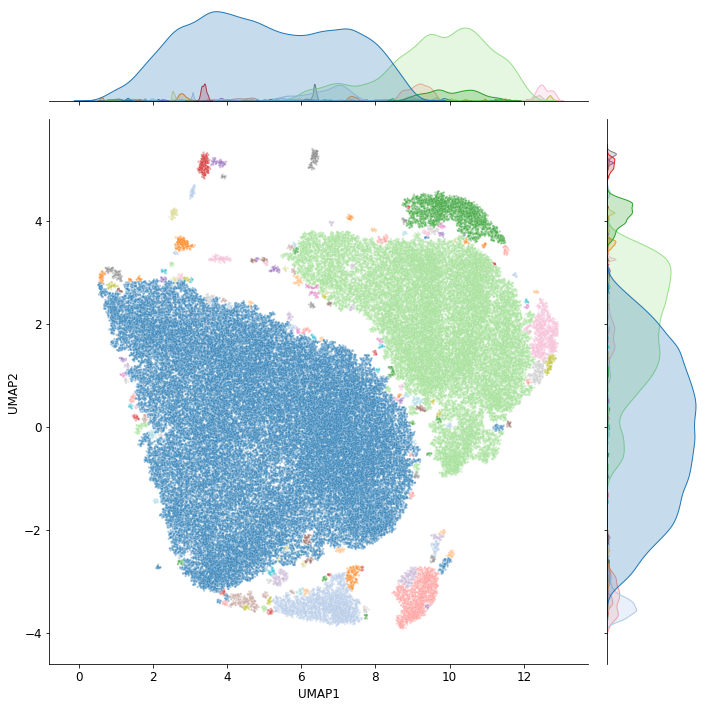

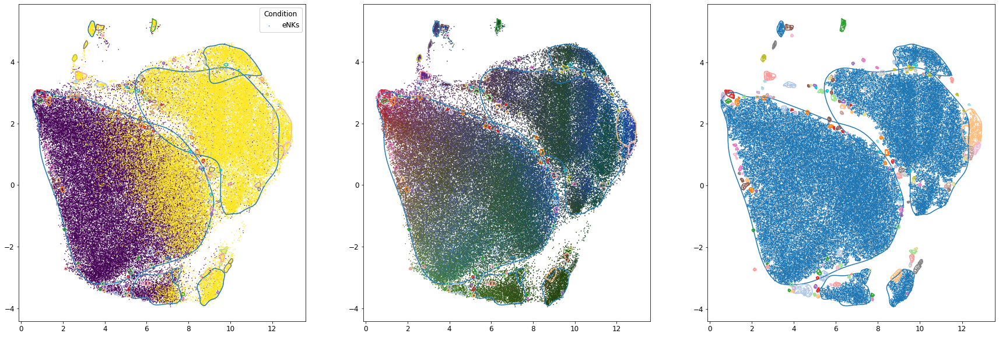

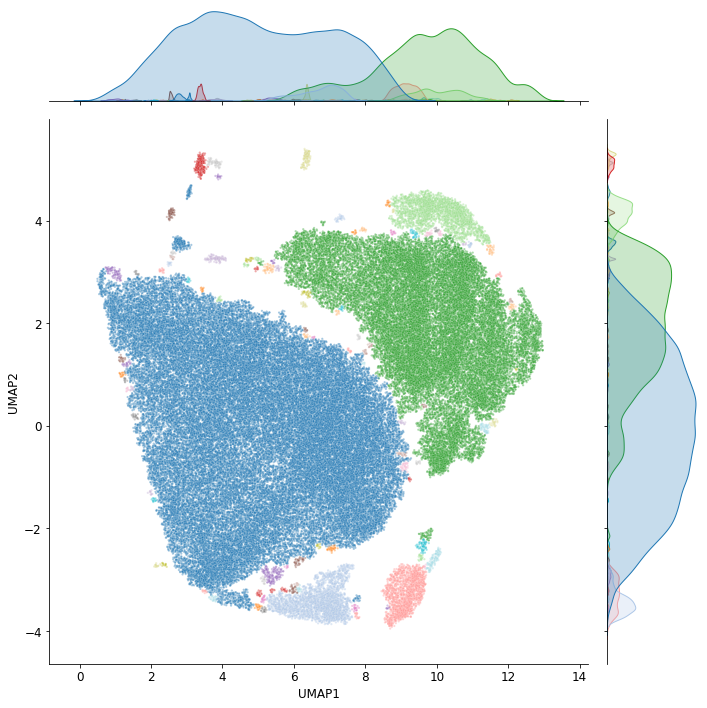

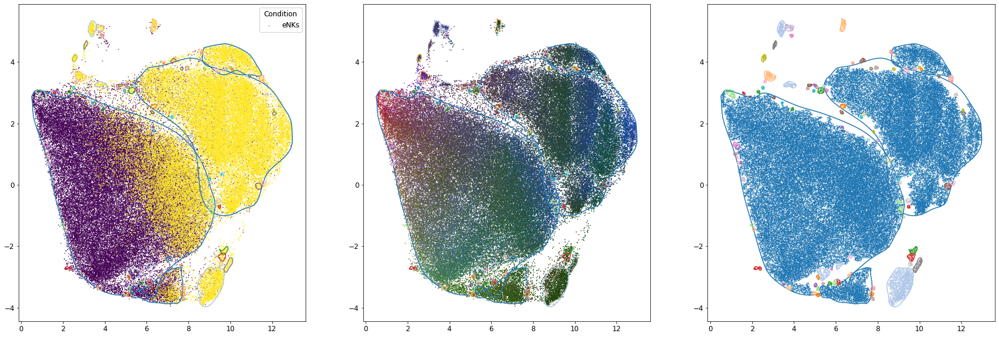

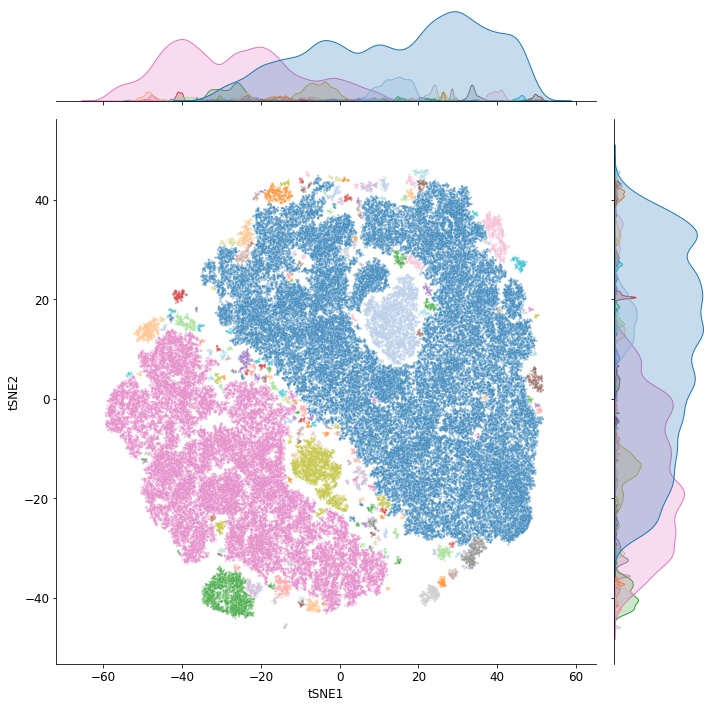

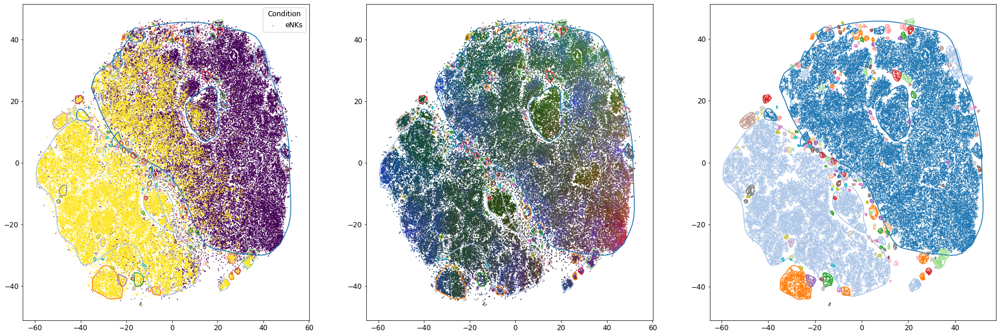

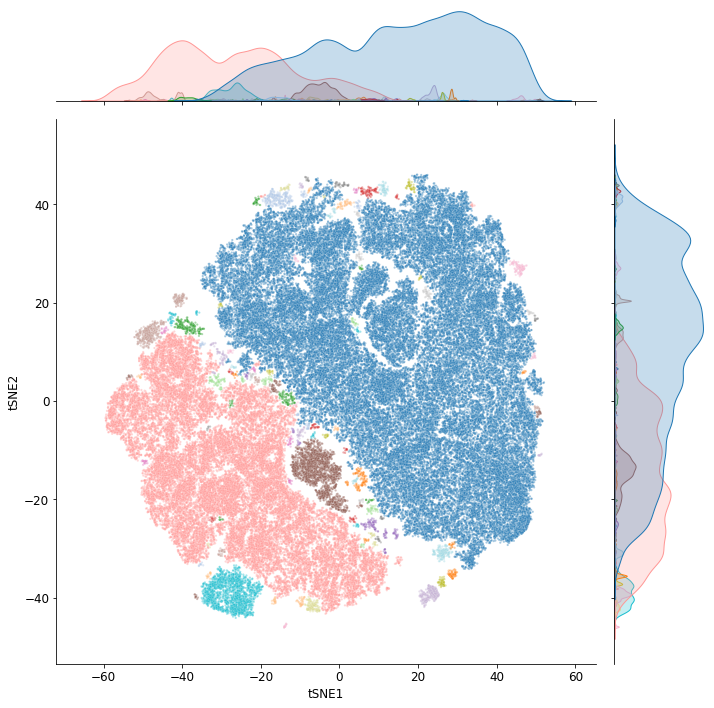

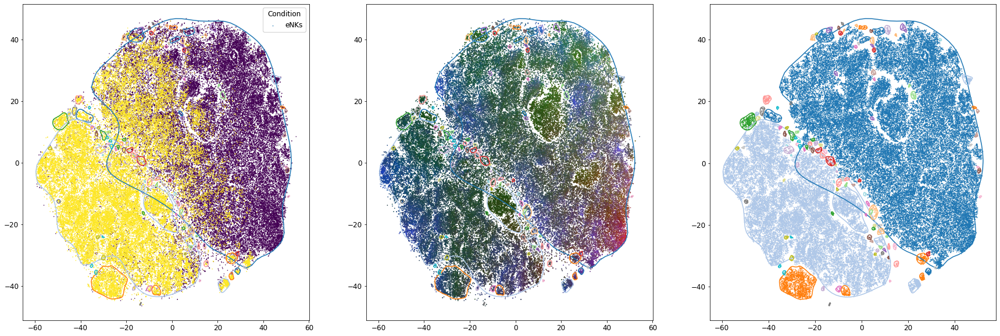

In [22]:

# Define the range of eps values to sweep across
eps_low = 0.023  # lower value
eps_high = 0.025  # upper value
eps_n = 2   # how many iterations (how many plots to generate)

eps_vals = np.round(np.linspace(eps_low, eps_high, eps_n),3)      

methods = ['umap', 'tsne']

for dr_method in methods:    
    for eps in eps_vals:

        lab_dr_df = cp.dbscan_clustering(dr_df,eps=eps,cluster_by=dr_method, plot=True)
        print('eps: ', eps, ' clusters: ', len(lab_dr_df['label'].unique()))
        fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=[30,10])
        cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='condition',legend=False,ax=ax1,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'condition')
        cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='PCs',ax=ax2,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'pca')
        cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='cluster',ax=ax3,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'cluster')

        fig.show()

        if cp.STATIC_PLOTS:
            plt.savefig(cp.CLUST_PARAMS_DIR+dr_method+'_sweep_eps_'+str(eps)+'nclusters_'+str(len(lab_dr_df['label'].unique()))+'.png', dpi=300)

print('Finished sweeping dbscan clustering. See output directory: ',cp.CLUST_PARAMS_DIR)          
            



### INTENTIONALLY CREATE THE LAB_DR_DF

dbscan_clustering() with eps =  0.025
DBScan clustering by UMAP...
Clustering generated: 113 subgoups.


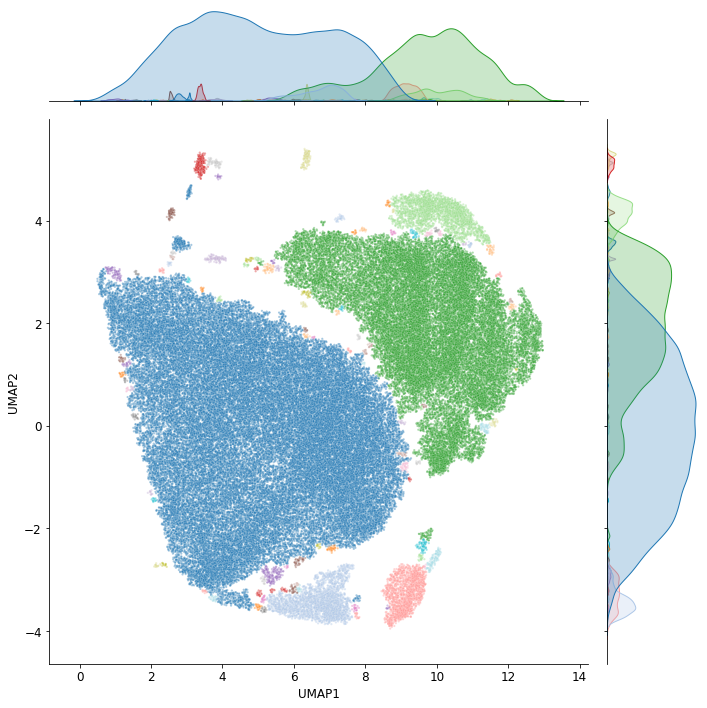

In [66]:
'''
Add here a very clear, intentional step where the lab_dr_df is generated with the
parameters sweeped in the notebook above. 
'''
# eps = None
eps = 0.025
dr_method = 'umap'

if eps is None:
    lab_dr_df = cp.hdbscan_clustering(dr_df,cluster_by=dr_method, plot=False)

else:
        
    lab_dr_df = cp.dbscan_clustering(dr_df,eps=eps,cluster_by=dr_method, plot=True)
# 

### DR: Further filtering downstream of dimensionality reduction

### Example filtering usage (ALL):
Removes entire cell tracks that don't fulfill the criteria. Example: Find cells that maintained a speed between 5-100um/min throughout their trajectory.
### Example filtering usage (ANY):
Removes DATAPOINTS that don't fulfill the criteria. If a cell in a cell track at any point dips below 5 um/min, then cut out that datapoint, but keep the rest of the datapoints from that track. The 'all' way is rather more reliable, because it won't mess up trajectory mapping.

In [37]:
lab_dr_df['Cond_label']


0              Condition_PBMCeNK_20x
1              Condition_PBMCeNK_20x
2              Condition_PBMCeNK_20x
3              Condition_PBMCeNK_20x
4              Condition_PBMCeNK_20x
                    ...             
99598    Condition_PBMCeNK_20x_cytoD
99599    Condition_PBMCeNK_20x_cytoD
99600    Condition_PBMCeNK_20x_cytoD
99601    Condition_PBMCeNK_20x_cytoD
99602    Condition_PBMCeNK_20x_cytoD
Name: Cond_label, Length: 99603, dtype: object

Applying filters:
{'area': (50, 10000), 'ntpts': (12, 180)}
Beginning filtering ...
99603  data points from  1765  cells
Applying filters to entire cell trajectory:
{'area': (50, 10000), 'ntpts': (12, 180)}
...
 Finished filtering. Resulting dataframe contains:
50154  data points from  690  cells


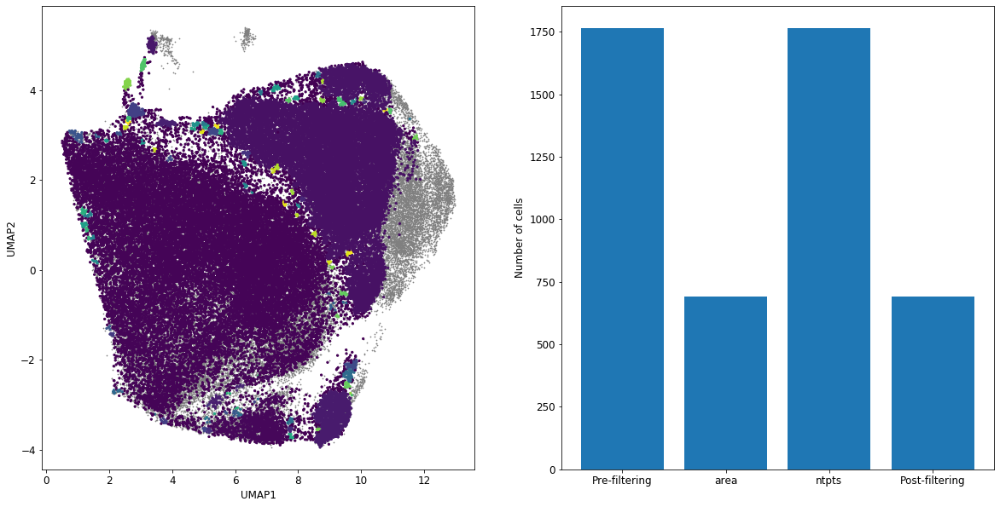

In [44]:
# Filter after dimensionality reduction
filters = {
#   "tSNE1": (-100, 100), 
#   "tSNE2": (-100, 100), 
#   "area": (200, 600), 
  "area": (50, 10000), # Warning: range will change if self-normalized
  "ntpts": (12,180),
# "endpoint_dir_ratio": (0.15,1),
#     "Cond_label": ('Condition_PBMCeNK_20x_cytoD','Condition_PBMCeNK_20x_cytoD')
}

# Apply the post-dimensionality reduction filters and visualize the results.
filt_dr_df, filt_list = cp.apply_filters(lab_dr_df,how='all', filter_dict=filters) # 'all is default behaviour', can be left out. 
fig = cp.visualize_filtering(lab_dr_df, filt_list, plot_by='umap') #Visualize filtering needs extended to show a metric of interest

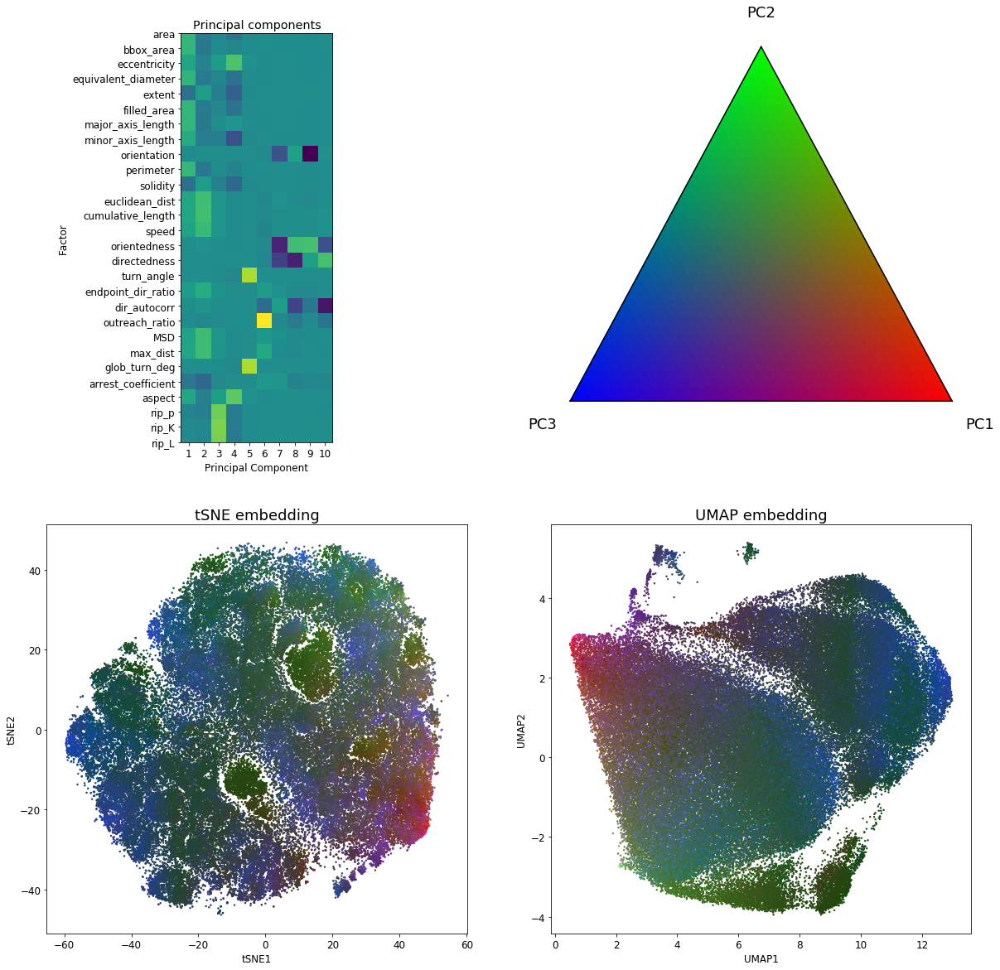

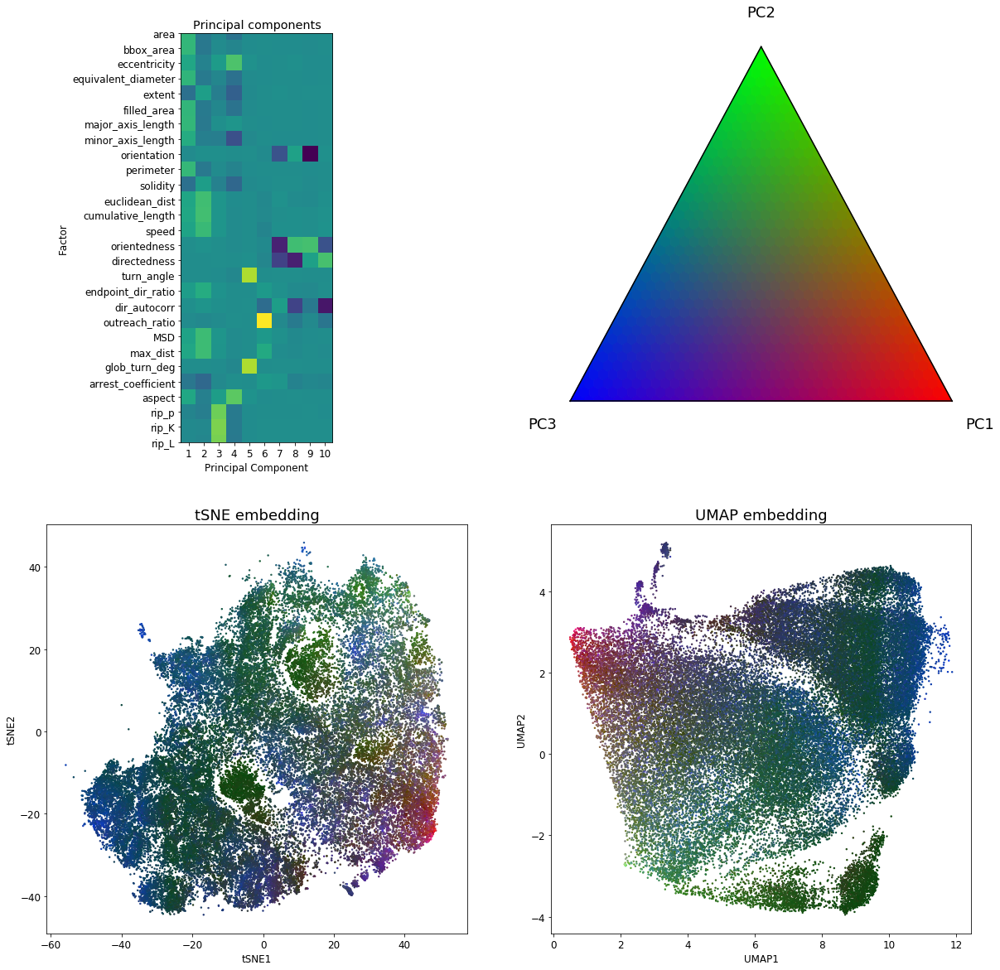

In [48]:
# It would actually be really nice here to just get a way to PLOT THE FINAL PLOTS AND SAVE THEM RATHER THAN HUNTING THROUGH THE NOTEBOOK

f=cp.dimension_reduction_subplots(lab_dr_df,pca_tuple=[pca_df, components, expl])
f=cp.dimension_reduction_subplots(filt_dr_df,pca_tuple=[pca_df, components, expl])

### DR: Deliberately save the filt_dr_df as the new lab_dr_df

In [ ]:
lab_dr_df = filt_dr_df #So that you can save it later....

### Update the DFs

In [55]:
'''
Optionally, save the results of this fine-tuning to the shared data folder
so the new results can be used by other notebooks.
'''
OVERWRITE_DATAFRAMES = True


if OVERWRITE_DATAFRAMES:
    # Save dataframes to shared data folder
    tavg_df.to_csv(cp.SAVED_DATA_PATH + 'tavg_df.csv')
    comb_df.to_csv(cp.SAVED_DATA_PATH + 'comb_df.csv')
    dr_df.to_csv(cp.SAVED_DATA_PATH + 'dr_df.csv')
    lab_dr_df.to_csv(cp.SAVED_DATA_PATH + 'lab_dr_df.csv')

### DR: Separate out the migration vs the shape characteristics and plot separately



Using openTSNE with perplexity =  185
Using openTSNE to calculate new embedding for input data.
Embedding shape:  (99603, 2)
Using openTSNE with perplexity =  185
Using openTSNE to calculate new embedding for input data.
Embedding shape:  (99603, 2)
Using openTSNE with perplexity =  185
Using openTSNE to calculate new embedding for input data.
Embedding shape:  (99603, 2)
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by tSNE...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by tSNE...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by tSNE...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by UMAP...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by UMAP...
hdbscan_clustering() with min_cluster_size =  20
DBScan clustering by UMAP...


<Figure size 720x720 with 0 Axes>

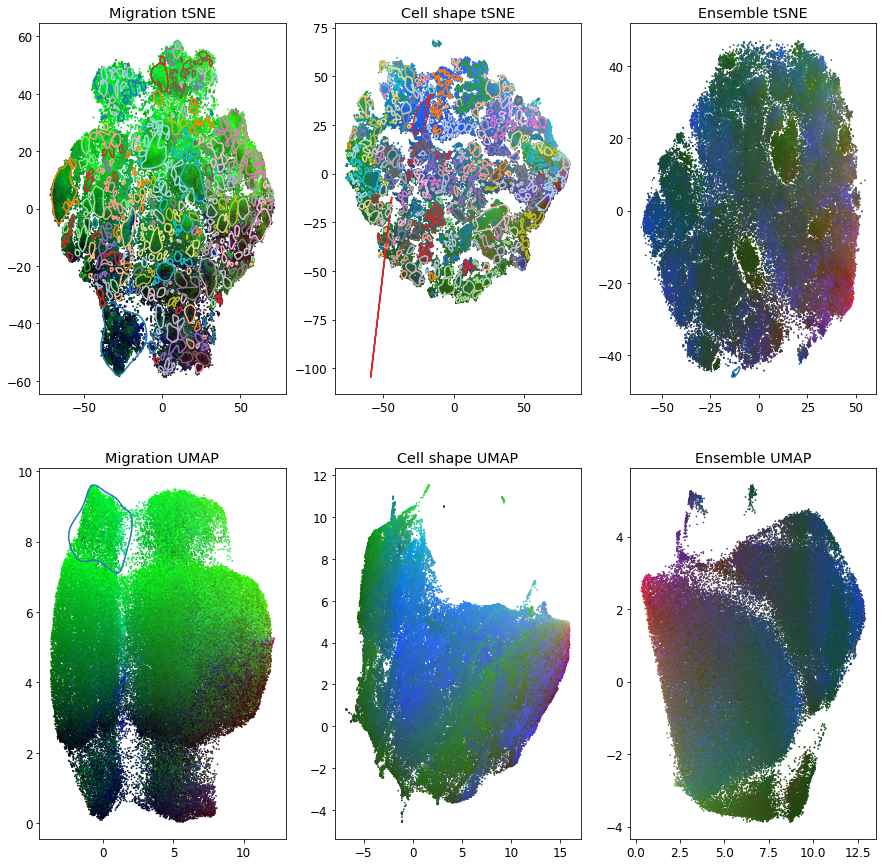

In [51]:
'''
A great improvement will be to colormap by PC values (triangular)
and add make cluster contours for each group.  (hdbscan)
'''
perplexity= 185
umap_nn= 50
min_dist= 0.2


cp.compare_mig_shape_factors(comb_df, #somereason, it didn't work for the lab_dr_df. That's OK because you are doing new filtering
                          dr_factors_mig=cp.MIG_FACTORS,
                          dr_factors_shape=cp.REGIONPROPS_LIST, 
                          dr_factors_all=cp.MIG_FACTORS+cp.REGIONPROPS_LIST+cp.ADDITIONAL_FACTORS,
                            perp=perplexity,umap_nn=umap_nn, min_dist=min_dist
                         )
                       
    
    # NOTE: What EPS value is used for this: HDBSCAN. CHANGEABLE?
    #NOTE: What UMAP isn't listed. Make sure you change that!

### DR: analysis! Find out where things are in the DR plot. But you should be able to already from the key

Applying filters:
{'label': (2, 2)}
Beginning filtering ...
99603  data points from  1765  cells
Applying filters to entire cell trajectory:
{'label': (2, 2)}
...
 Finished filtering. Resulting dataframe contains:
2893  data points from  27  cells


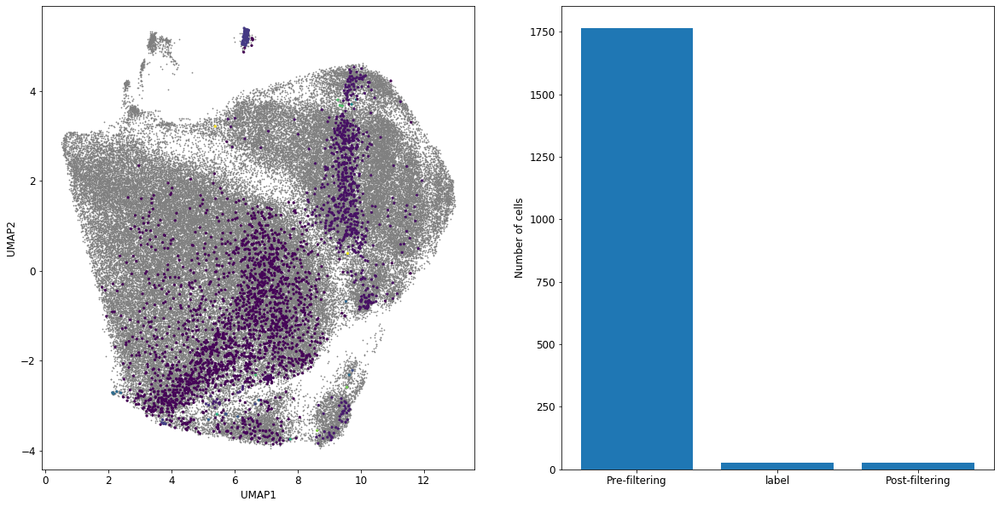

In [54]:
# Filter cells that were a part of clusterid == 5 at some point in their trajectory.
filters = {
  "label": (2, 2) 
}

'''
To apply sequentially, pass the results of the previous filtering operation to apply_filters()
    filt_dr_df
    
To see influence of new 'any' filter in isolation, use lab_dr_df as input.
''' 

filt_dr_df, filt_list = cp.apply_filters(lab_dr_df,how='any', filter_dict=filters) # 'all' is default behaviour
fig = cp.visualize_filtering(lab_dr_df, filt_list, plot_by='umap')

### Here, you need a way to simply plot out different parts of the lab_dr_df: conditional based on cond_label, conditional based on cluster label as scatters - use the seaborn one?

### DF: cluster colocalization

['eNKs' 'eNKs CytoD']
['eNKs' 'eNKs CytoD']


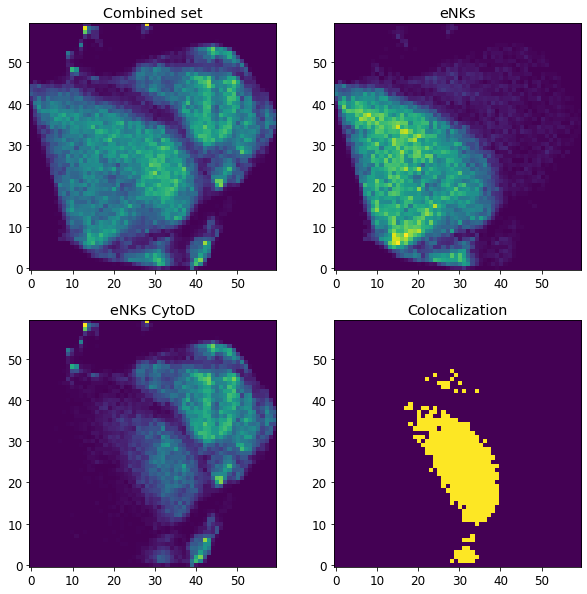

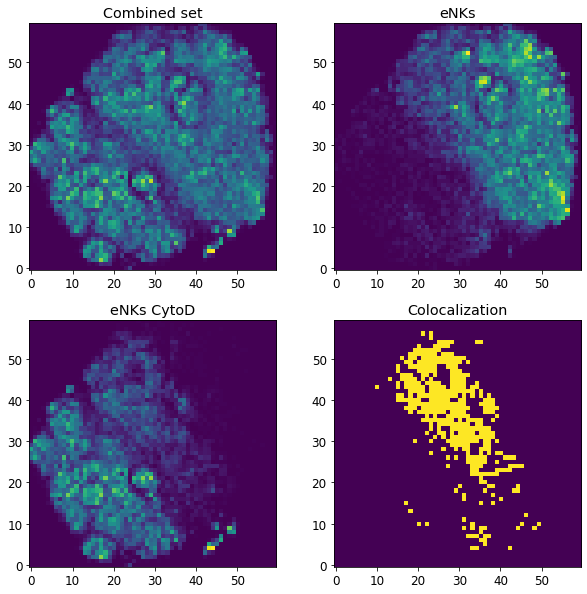

In [60]:
f=cp.spatial_img_coloc(lab_dr_df, xy='umap',thresh=10,n_bins=60)
f=cp.spatial_img_coloc(lab_dr_df, xy='tsne',thresh=10,n_bins=60)

In [9]:
pca_df, components, expl = cp.do_pca(comb_df[cp.DR_FACTORS])

['eNKs' 'eNKs CytoD']
['eNKs' 'eNKs CytoD']


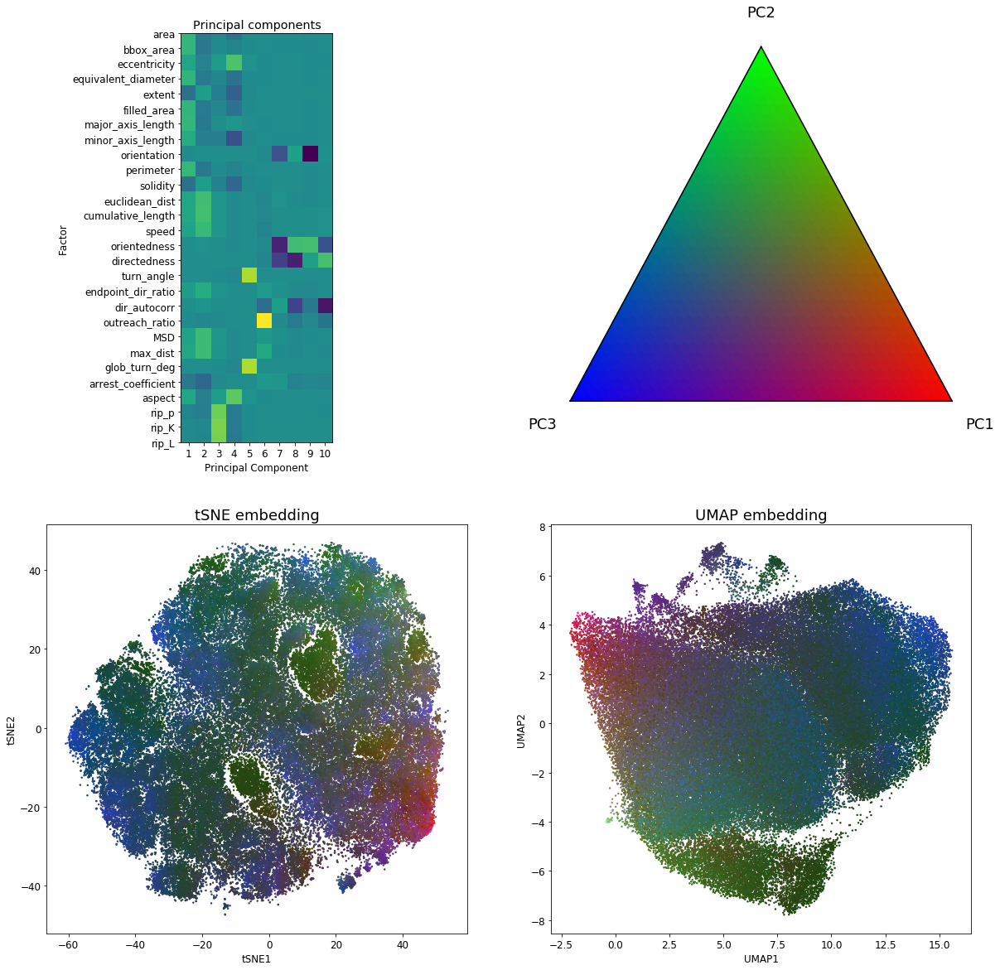

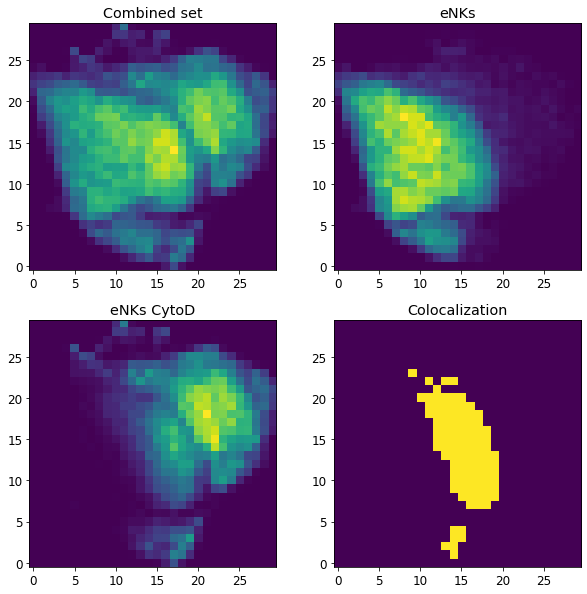

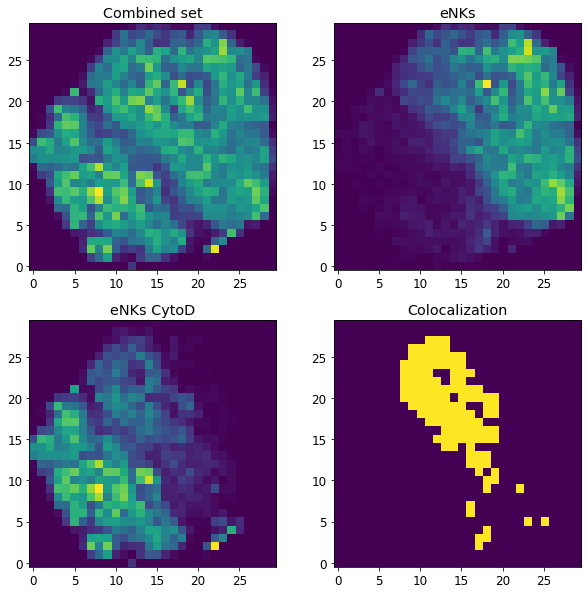

In [10]:
f=cp.dimension_reduction_subplots(dr_df,pca_tuple=[pca_df, components, expl])
f=cp.spatial_img_coloc(dr_df, xy='umap',thresh=40,n_bins=30)
f=cp.spatial_img_coloc(dr_df, xy='tsne',thresh=40,n_bins=30)

### Cluster the cell behaviour

In [61]:
cp.CONDITIONS_TO_INCLUDE

['Condition_PBMCeNK_20x', 'Condition_PBMCeNK_20x_cytoD']

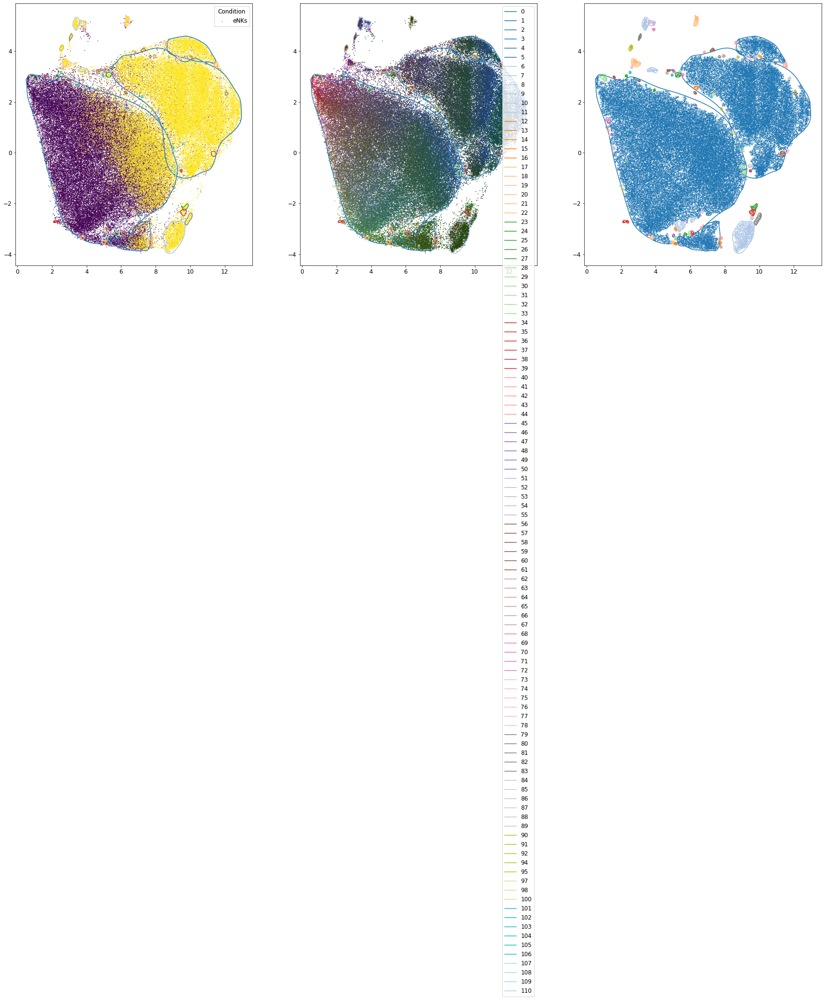

In [67]:
# Check whether this uses the settings you chose above...(in HDBSCAN_CLUSTERING)


dr_method = cp.CLUSTER_BY
# dr_method = 'tsne'

# lab_dr_df = cp.hdbscan_clustering(dr_df, cluster_by=dr_method, plot=True) #Note this redefines lab_dr_df 

fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=[30,10])
# fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=[150,50])
cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='condition',ax=ax1,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'condition')
cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='PCs',ax=ax2,legend=True,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'pca')
cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='cluster',ax=ax3,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'cluster')


# THIS SECTION IS FOR PLOTTING DIFFERENT ASPECTS OF THE FINISHED DR

In [95]:
def scatter_subplots(df_in, dr_method='tSNE'):

    '''
    Visualize dimensionally reduced space as a histogram and perfrom image
    collocalization between the images.

    TO DO: Update this to work for the inputted conditions...
    By Default it assumes the first is the control and the second is for comparison.
    '''


    if(dr_method == 'tsne' or dr_method == 'tSNE'):

            x_lab = 'tSNE1'
            y_lab = 'tSNE2'

    elif dr_method == 'PCA':

            x_lab = 'PC1'
            y_lab = 'PC2'

    elif (dr_method == 'umap' or dr_method == 'UMAP'):

            x_lab = 'UMAP1'
            y_lab = 'UMAP2'

    df = df_in.copy()

    # Get the list of conditions included in the dataframe. By default show the first two.
    cond_list = df['Condition_shortlabel'].unique()
    print(cond_list)

    fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2,  figsize=(20,20))

    ax1.title.set_text('Combined set')
    # ax2.title.set_text(CTL_LABEL)
    # ax3.title.set_text(CONDITIONS_TO_INCLUDE[1])
    # ax2.title.set_text(CONDITION_SHORTLABELS[0])
    # ax3.title.set_text(CONDITION_SHORTLABELS[1])
    ax2.title.set_text(cond_list[0])
    ax3.title.set_text(cond_list[1])
    ax4.title.set_text('Combined set with cluster outlines')


    # xy_range = [[-60, 60], [-40, 40]]
    xy_range = [[np.min(df[x_lab]), np.max(df[x_lab])], [np.min(df[y_lab]), np.max(df[y_lab])]]

    ax1.scatter(x=df[x_lab],y=df[y_lab], c=df['label'],s=0.5, alpha=0.5)

    ctl_df = df[df['Condition_shortlabel']==cond_list[0]]#CONDITION_SHORTLABELS[0]]

    ax2.scatter(x=ctl_df[x_lab],y=ctl_df[y_lab], c=ctl_df['label'],s=0.5, alpha=0.5)



    comp_df = df[df['Condition_shortlabel']==cond_list[1]]#CONDITION_SHORTLABELS[1]]

    ax3.scatter(x=comp_df[x_lab],y=comp_df[y_lab], c=comp_df['label'],s=0.5, alpha=0.5)


    
    sns.scatterplot(data=df, hue='Condition_shortlabel', x=x_lab, y=y_lab, ax=ax4, s=0.2, alpha=0.4)
    ax4.legend()
    #         ax.scatter(x=sub_df[x_lab],y=sub_df[y_lab], c=sub_df['Condition_shortlabel'].values(), s=1, alpha=1)
    cp.draw_cluster_hulls(df,cluster_by=dr_method, color_by='condition',ax=ax4,draw_pts=False,save_path=cp.CLUST_PARAMS_DIR+'temp')

#     cp.draw_cluster_hulls(df,cluster_by=dr_method, color_by='condition',ax=ax4,draw_pts=True,save_path=cp.CLUST_PARAMS_DIR+'condition')


    
    if STATIC_PLOTS:

        plt.savefig(DR_DIR +str(dr_method)+'_4panel_scatter_multi-condition.png', format='png', dpi=600)

#     if PLOTS_IN_BROWSER:

#         fig.show()
       
    

    return fig

['eNKs' 'eNKs CytoD']


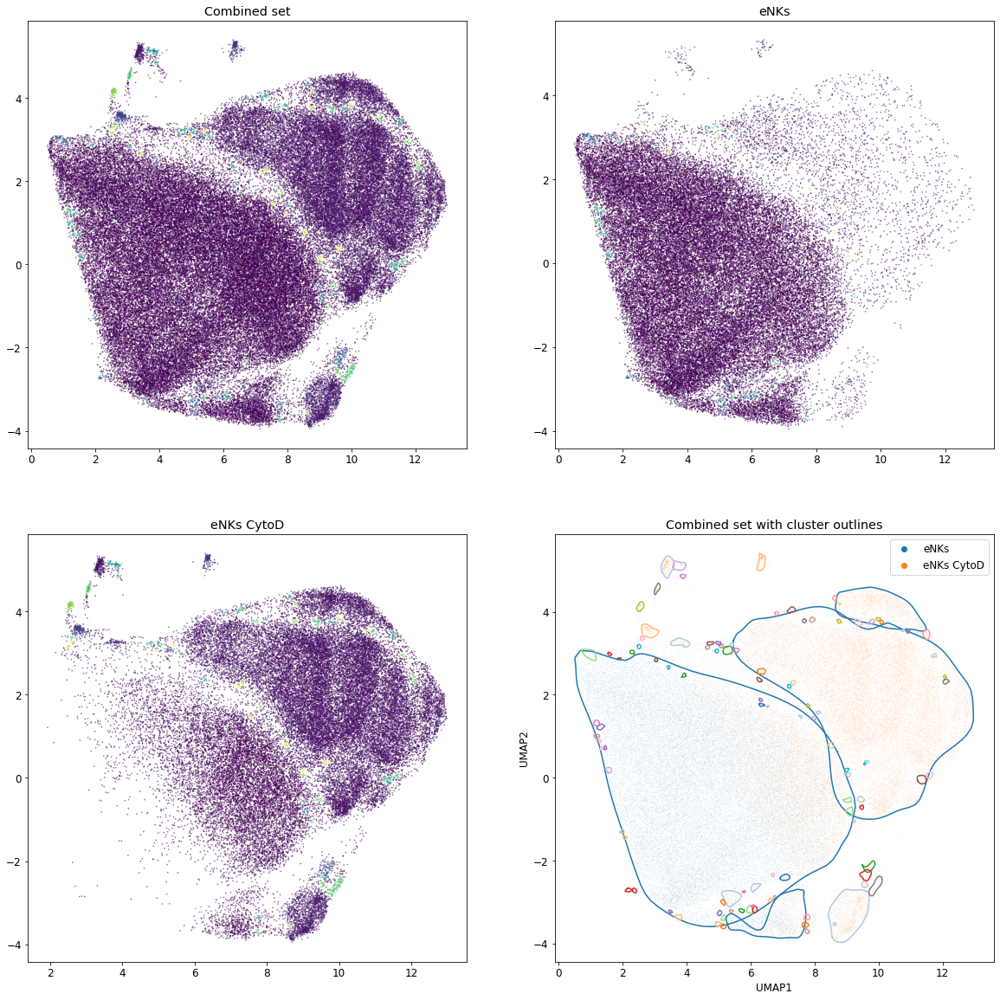

In [97]:
STATIC_PLOTS = False

f = scatter_subplots(lab_dr_df, dr_method='umap')

[]


IndexError: index 0 is out of bounds for axis 0 with size 0

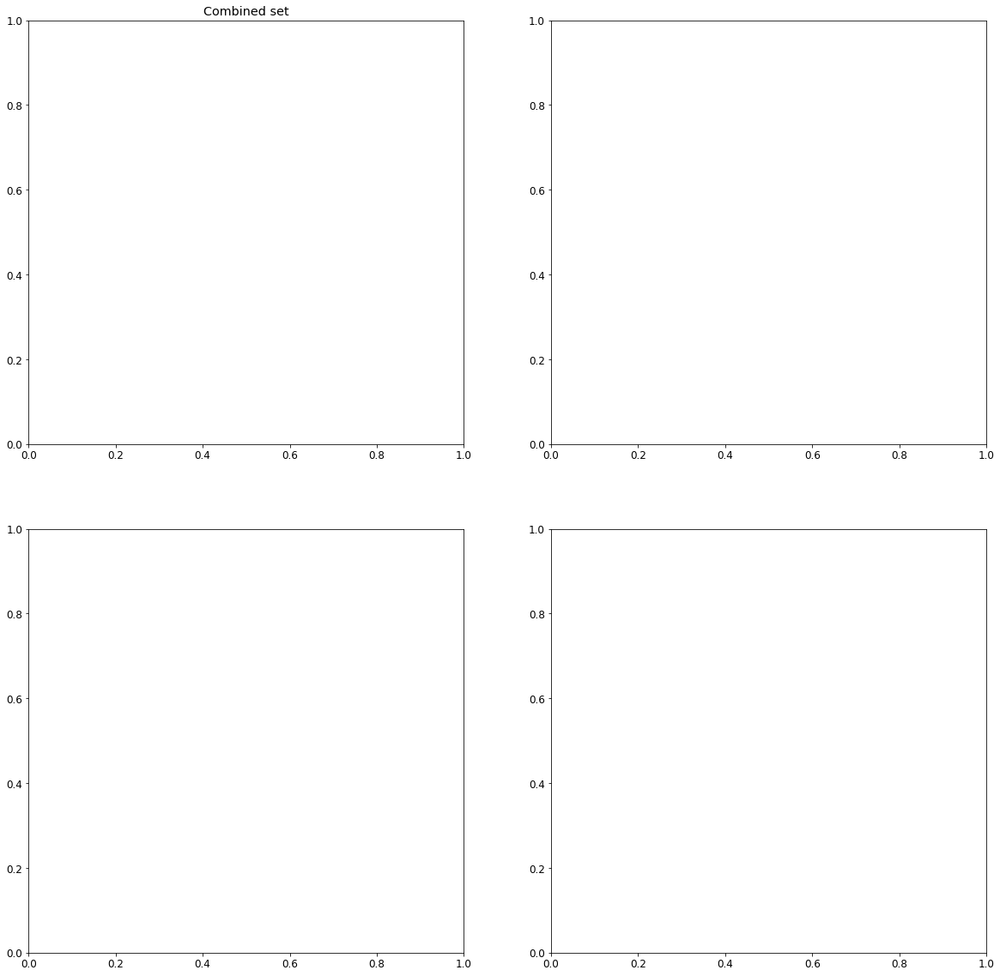

In [99]:
sub_df_1 = lab_dr_df[lab_dr_df['Condition_shortlabel'].str.contains('20x')]
sub_df_2 = lab_dr_df[lab_dr_df['Condition_shortlabel'].str.contains('cytoD')]

dr_method = 'UMAP'
f1 = scatter_subplots(sub_df_1,dr_method=dr_method)
f2 = scatter_subplots(sub_df_2,dr_method=dr_method)
# f1=vis.spatial_img_coloc(sub_df_1, xy=xy,thresh=20,n_bins=100)
# f2=vis.spatial_img_coloc(sub_df_2, xy=xy,thresh=20,n_bins=100)

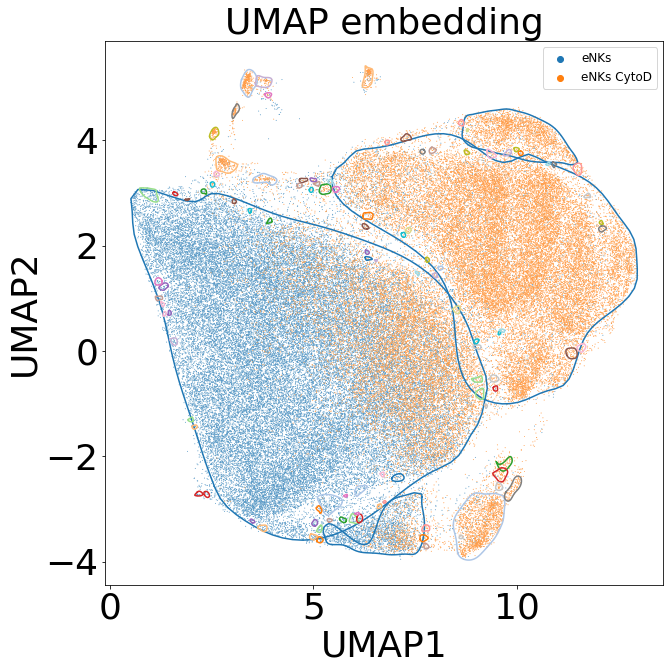

In [107]:
def multi_conditon_scatter(dr_df, dr_method = 'umap'):




    if(dr_method == 'tsne' or dr_method == 'tSNE'):

        x_lab = 'tSNE1'
        y_lab = 'tSNE2'

    elif dr_method == 'PCA':

        x_lab = 'PC1'
        y_lab = 'PC2'

    elif (dr_method == 'umap' or dr_method == 'UMAP'):

        x_lab = 'UMAP1'
        y_lab = 'UMAP2'



    fig, ax = plt.subplots()

    sns.scatterplot(data=lab_dr_df, hue='Condition_shortlabel', x=x_lab, y=y_lab, ax=ax, s=0.9, alpha=0.9)
    ax.legend()
    #         ax.scatter(x=sub_df[x_lab],y=sub_df[y_lab], c=sub_df['Condition_shortlabel'].values(), s=1, alpha=1)
    cp.draw_cluster_hulls(lab_dr_df,cluster_by=dr_method, color_by='condition',ax=ax,draw_pts=False,save_path=cp.CLUST_PARAMS_DIR+'temp')

    ax.set_title(dr_method+ ' embedding', fontsize=36)
    ax.set_xlabel(x_lab, fontsize=36)
    ax.set_ylabel(y_lab, fontsize=36)
    ax.tick_params(axis='both', labelsize=36)

#     fig.savefig(DR_DIR+dr_method+'multi-conditon_scatter', dpi=300)
    
    
multi_conditon_scatter(dr_df, dr_method)

### Cluster switching analysis

In [78]:
# Count the cluster changes and number of labels
sum_labels, tptlabel_dr_df = cp.count_cluster_changes(lab_dr_df)
display(sum_labels)




KeyboardInterrupt: 

In [82]:
display(tptlabel_dr_df)


,Unnamed: 0,index,rep_row_ind,frame,x,y,z,_,particle,area,...,PC8,PC9,PC10,tSNE1,tSNE2,UMAP1,UMAP2,label,n_changes,n_labels
0,0,0,0,0.0,799.329590,494.029968,0.0,0.0,3.0,76.994523,...,0.798460,-0.544353,-0.797448,32.072797,36.243831,3.310176,-2.866371,0,0,1
1,1,2,2,0.0,594.805664,9.274881,0.0,0.0,5.0,60.845859,...,0.768901,-0.616434,-0.915942,26.186138,35.237281,4.310973,-3.522140,-1,0,1
2,2,3,3,0.0,282.206512,8.706522,0.0,0.0,6.0,26.529948,...,0.832165,-0.485839,-0.902867,23.275203,38.648413,4.254394,-3.024634,0,1,2
3,3,5,5,0.0,802.851440,25.554285,0.0,0.0,8.0,100.929150,...,1.010701,-0.879747,-1.011996,45.933678,20.457652,2.420808,-1.144856,0,1,2
4,4,7,7,0.0,553.896545,64.684731,0.0,0.0,10.0,58.538907,...,0.737746,0.109192,-1.094955,35.100931,34.723399,3.657976,-3.085295,0,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99598,99598,117542,50429,179.0,275.939758,927.138550,0.0,0.0,267.0,95.738508,...,0.886528,0.627774,0.441969,-3.034994,-21.131867,7.973276,3.836713,63,6,4
99599,99599,117543,50430,179.0,745.479614,970.051025,0.0,0.0,280.0,56.520324,...,-0.198791,-1.671495,2.984197,-10.432343,-15.728679,8.901973,-3.627551,7,6,4
99600,99600,117544,50431,179.0,519.621338,1006.883484,0.0,0.0,287.0,59.404014,...,-1.237406,-1.108679,-0.539537,-6.275437,-10.017651,9.297428,-3.416692,7,7,4
99601,99601,117545,50432,179.0,888.057983,722.318848,0.0,0.0,385.0,39.794922,...,-0.781624,-0.784740,0.193217,-38.779961,14.728321,8.910182,-3.270842,7,8,4


In [1]:
cp.time_superplot(tptlabel_dr_df, 'speed',t_window=6)#n_labels

# cp.time_superplot(tptlabel_dr_df, factor, x_range=[0,30],y_range= [0, 50]) #THIS VERSION ALLOWS AXIS CONTROL

NameError: name 'cp' is not defined

In [80]:
cp.time_superplot(tptlabel_dr_df, 'n_changes',t_window=6)


# Updated time superplots where x_range and y_range are user defined. 
# cp.time_superplot(tptlabel_dr_df, factor, x_range=[0,30],y_range= [0, 50]) #THIS VERSION ALLOWS AXIS CONTROL

In [90]:
cp.timeplots_of_differences(tptlabel_dr_df, factor='n_changes')

In [83]:
tavg_df = cp.time_average(tptlabel_dr_df)

### HERE YOU DEFINE A NEW FUNCTION FOR MULTI-CONDITION TIMEPLOT

In [91]:
import plotly.graph_objects as go
import seaborn as sns

def multi_condition_timeplot(df, factor,t_window=None, savepath=cp.TIMEPLOT_DIR):

    '''
    Convert a dataframe with a specified parameter into a plot that shows
    that parameter changing over the course of the experiment.

    Input:
        df: DataFrame
        factor: String: column title for the factor to be visualized.

    Returns:
        fig_data: Plotly graph data
    '''

    cond_grouping = 'Condition'
    rep_grouping = 'Replicate_ID'

    if(cp.USE_SHORTLABELS):
        cond_grouping = 'Condition_shortlabel'
        rep_grouping = 'Replicate_shortlabel'

    fig1_data = [] # Define as an empty list to add traces

    # Frames to be calculated ones for the whole set
    n_frames = int(np.max(df['frame']))


    # palette = 'tab10'
    colors = sns.color_palette(cp.PALETTE, n_colors=len(df[cond_grouping].unique()))
    fig_data_list = []

    # Loop for each condition
    for i, cond in enumerate(df[cond_grouping].unique()):


        fac_array = cp.timeavg_mean_error(df[df[cond_grouping]==cond], n_frames,factor,t_window)

        fig1_data = cp.timeplot_sample(fig1_data, factor, fac_array, n_frames,
                       color_rgb = colors[i],label=cond)

    fig_data_list.append(fig1_data)

    fig = go.Figure(fig1_data)
            
            
#     fig = go.Figure(fig_subplots)

    fig.update_layout(
            title_text=factor+ " as a function of time",
            autosize=False,
            width=1500,
            height=500,

                legend=dict(
                orientation="v",
                yanchor="bottom",
                y=0,#-0.4,
                xanchor="left",
                x=1,
                traceorder='normal'
            ))

    # Specify axis labels
    fig['layout']['xaxis']['title']='Time (min)'
#     fig['layout']['xaxis2']['title']='Time (min)'
    fig['layout']['yaxis']['title']= factor
#     fig['layout']['yaxis2']['title']= factor


    if STATIC_PLOTS:
        fig.write_image(savepath+str(factor)+'_timeplot_multi-condition.png')

    if PLOTS_IN_BROWSER:

        fig.show()

    return fig

In [94]:
# ['euclidean_dist',     # Valid?
#                 'cumulative_length', # Valid?
#                 'speed',
#                 'orientedness', # name changed from orientation
#                 'directedness',
#                 'turn_angle',
#                 'endpoint_dir_ratio',
#                 'dir_autocorr',
#                 'outreach_ratio',
#                 'MSD',                # Valid?
#                 'max_dist',           # Valid?
#                 'glob_turn_deg',
#                 'arrest_coefficient']

# ['aspect', 'rip_p', 'rip_K', 'rip_L']

STATIC_PLOTS = True
PLOTS_IN_BROWSER = False


'''
This version will be modified to only show the final (combined) plot
'''
factor = 'n_changes'
multi_condition_timeplot(tptlabel_dr_df, factor)

In [87]:
# Make a superplot of this
factor = 'n_labels'
cp.superplots_plotly(tavg_df, factor, t='timeaverage')


In [85]:
# Time-averaged plots of differences
factor = 'n_changes' #n_labels
ctl_label = cp.CONDITIONS_TO_INCLUDE[0]

cp.plots_of_differences_plotly(tavg_df, factor=factor, ctl_label=ctl_label)#, ='CTL_LABEL')

eNKs CytoD vs eNKs: P = 0.0
P =  0.0  (Using t-test without multiple comparison correction)
------


In [115]:
tptlabel_dr_df

,Unnamed: 0,index,rep_row_ind,frame,x,y,z,_,particle,area,...,PC8,PC9,PC10,tSNE1,tSNE2,UMAP1,UMAP2,label,n_changes,n_labels
0,0,0,0,0.0,799.329590,494.029968,0.0,0.0,3.0,76.994523,...,0.798460,-0.544353,-0.797448,32.072797,36.243831,3.310176,-2.866371,0,0,1
1,1,2,2,0.0,594.805664,9.274881,0.0,0.0,5.0,60.845859,...,0.768901,-0.616434,-0.915942,26.186138,35.237281,4.310973,-3.522140,-1,0,1
2,2,3,3,0.0,282.206512,8.706522,0.0,0.0,6.0,26.529948,...,0.832165,-0.485839,-0.902867,23.275203,38.648413,4.254394,-3.024634,0,1,2
3,3,5,5,0.0,802.851440,25.554285,0.0,0.0,8.0,100.929150,...,1.010701,-0.879747,-1.011996,45.933678,20.457652,2.420808,-1.144856,0,1,2
4,4,7,7,0.0,553.896545,64.684731,0.0,0.0,10.0,58.538907,...,0.737746,0.109192,-1.094955,35.100931,34.723399,3.657976,-3.085295,0,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99598,99598,117542,50429,179.0,275.939758,927.138550,0.0,0.0,267.0,95.738508,...,0.886528,0.627774,0.441969,-3.034994,-21.131867,7.973276,3.836713,63,6,4
99599,99599,117543,50430,179.0,745.479614,970.051025,0.0,0.0,280.0,56.520324,...,-0.198791,-1.671495,2.984197,-10.432343,-15.728679,8.901973,-3.627551,7,6,4
99600,99600,117544,50431,179.0,519.621338,1006.883484,0.0,0.0,287.0,59.404014,...,-1.237406,-1.108679,-0.539537,-6.275437,-10.017651,9.297428,-3.416692,7,7,4
99601,99601,117545,50432,179.0,888.057983,722.318848,0.0,0.0,385.0,39.794922,...,-0.781624,-0.784740,0.193217,-38.779961,14.728321,8.910182,-3.270842,7,8,4


In [ ]:
# Filter cells that were a part of clusterid == 5 at some point in their trajectory.
filters = {
  "label": (2, 2) 
}

'''
To apply sequentially, pass the results of the previous filtering operation to apply_filters()
    filt_dr_df
    
To see influence of new 'any' filter in isolation, use lab_dr_df as input.
''' 

filt_dr_df, filt_list = cp.apply_filters(lab_dr_df,how='any', filter_dict=filters) # 'all' is default behaviour
fig = cp.visualize_filtering(lab_dr_df, filt_list, plot_by='umap')

In [ ]:
# Don't you need cumulative n_labels?

In [ ]:
##


### Trajectory analysis

Defining trajectories using: ( UMAP1 UMAP2 )
Completed distance matrix, shape:  (1765, 1765)
Determined maximum number of clusters where eps =   1.0


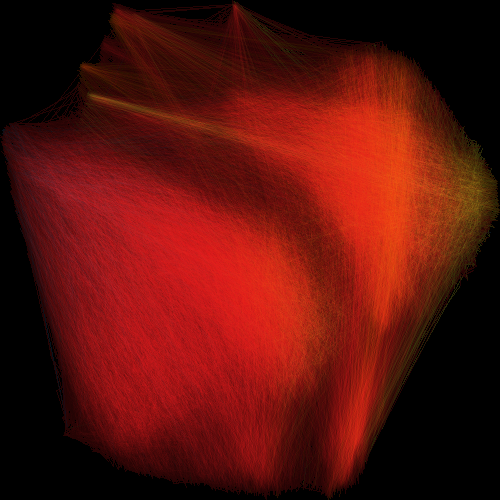

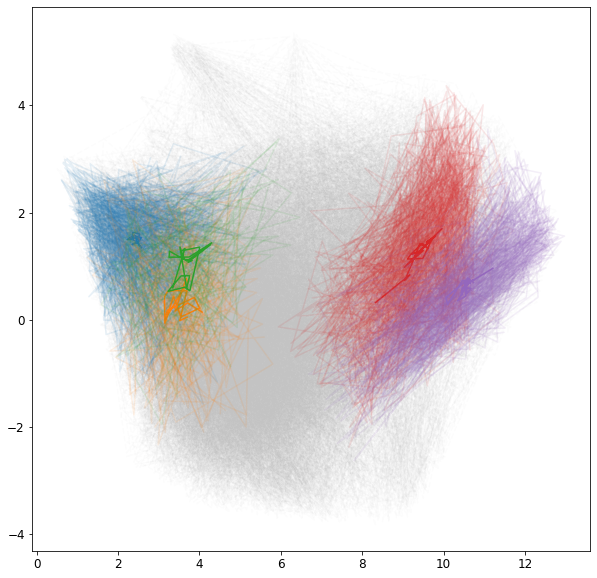

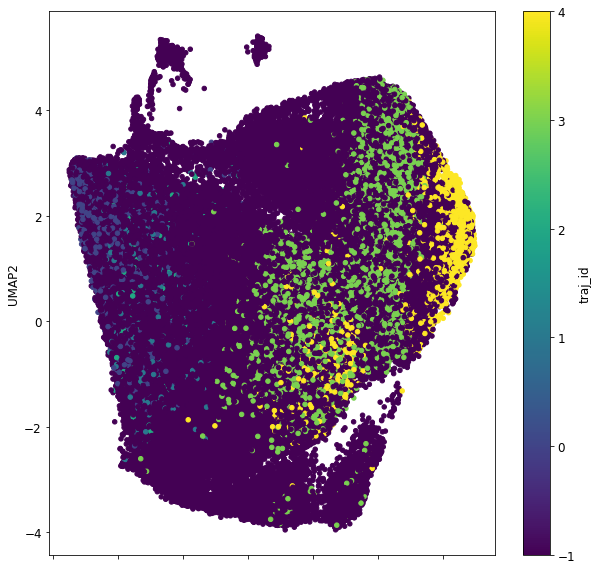

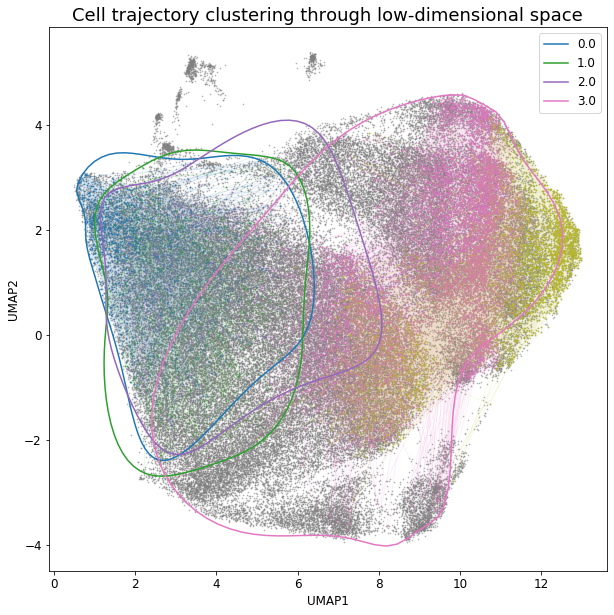

In [108]:
# Run the trajectory clustering pipeline
lab_dr_df, traj_list, cluster_lst = cp.trajectory_clustering_pipeline(lab_dr_df, traj_factor='umap', dist_metric='hausdorff', filename_out='std_dr_df_traj')

cp.plot_traj_cluster_avg(traj_list, cluster_lst, label='')
cp.trajectory_cluster_vis(lab_dr_df,traj_factor='umap', scatter=True)
cp.datashader_lines(lab_dr_df, 'UMAP1', 'UMAP2',color_by='traj_id', categorical=True, identifier='traj_id')

### Cluster Purity. Can this be done on cluster IDs?

In [109]:
clust_sum_df = cp.cluster_purity(lab_dr_df) 
display(clust_sum_df)
trajclust_sum_df = cp.cluster_purity(lab_dr_df, cluster_label='traj_id')
display(trajclust_sum_df)

,cluster_id,eNKs_ntpts,eNKs_ntpts_%,eNKs_ncells,eNKs_ncells_%,eNKs CytoD_ntpts,eNKs CytoD_ntpts_%,eNKs CytoD_ncells,eNKs CytoD_ncells_%
0,0.0,45399.0,79.662742,1355.0,77.340183,11590.0,20.337258,397.0,22.659817
1,1.0,1774.0,75.393115,411.0,80.588235,579.0,24.606885,99.0,19.411765
2,2.0,22.0,75.862069,21.0,77.777778,7.0,24.137931,6.0,22.222222
3,3.0,7.0,50.000000,7.0,50.000000,7.0,50.000000,7.0,50.000000
4,4.0,1996.0,6.892741,807.0,66.970954,26962.0,93.107259,398.0,33.029046
...,...,...,...,...,...,...,...,...,...
107,107.0,0.0,0.000000,0.0,0.000000,10.0,100.000000,10.0,100.000000
108,108.0,4.0,40.000000,4.0,57.142857,6.0,60.000000,3.0,42.857143
109,109.0,0.0,0.000000,0.0,0.000000,7.0,100.000000,7.0,100.000000
110,110.0,0.0,0.000000,0.0,0.000000,7.0,100.000000,6.0,100.000000


,cluster_id,eNKs_ntpts,eNKs_ntpts_%,eNKs_ncells,eNKs_ncells_%,eNKs CytoD_ntpts,eNKs CytoD_ntpts_%,eNKs CytoD_ncells,eNKs CytoD_ncells_%
0.0,0.0,1324.0,100.0,53.0,100.0,0.0,0.0,0.0,0.0
1.0,1.0,418.0,100.0,17.0,100.0,0.0,0.0,0.0,0.0
2.0,2.0,344.0,100.0,10.0,100.0,0.0,0.0,0.0,0.0
3.0,3.0,0.0,0.0,0.0,0.0,9123.0,100.0,65.0,100.0
4.0,4.0,0.0,0.0,0.0,0.0,3222.0,100.0,53.0,100.0


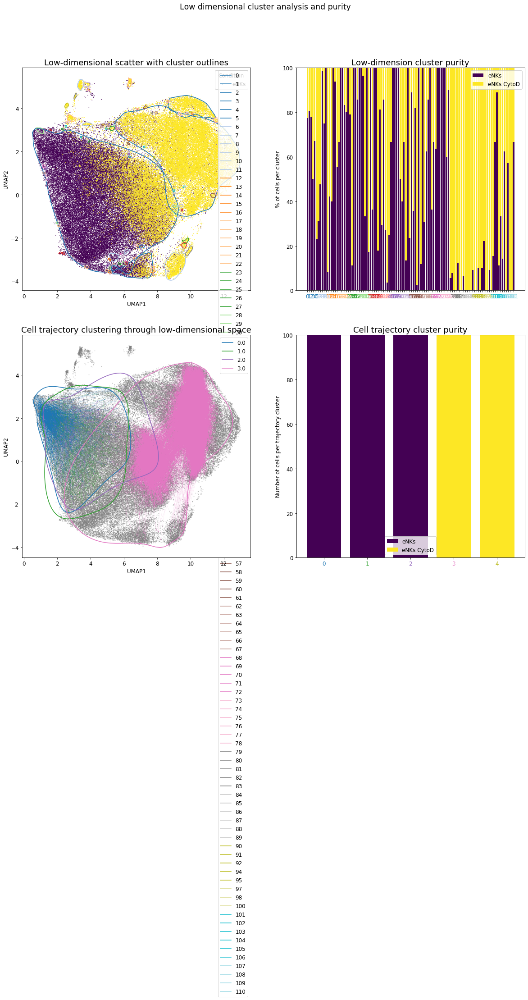

In [110]:
'''Note: accepts multiple dataframe inputs, could accept just one..'''
f = cp.purity_plots(lab_dr_df, clust_sum_df,lab_dr_df,trajclust_sum_df)

In [111]:
clust_sum_t_df = cp.cluster_composition_timecourse(lab_dr_df)
cp.cluster_timeplot(clust_sum_t_df)

In [112]:
# Count the number of cells that fall into each cluster - show on per condition and replicate basis.
lab_count_df = cp.get_label_counts(lab_dr_df, per_rep=True)

# Plot the counts per subgroup in a swarm plot
fig = px.strip(lab_count_df, x="label", y="count", color="Condition")
fig.show()

NameError: name 'px' is not defined

In [ ]:
# Right, its not clustering well. You at least want the two separated out. Do some cluster sweeping.









### Stuff that doesn't work: Cluster disambiguation

In [ ]:
cp.dr_contour_matrix(dr_df,n_grid_pts=4, dr_method='umap',t_window=12) # dr_method='umap'

In [ ]:
cp.dr_contour_matrix(dr_df,n_grid_pts=6, dr_method='tSNE',t_window=12) # dr_method='umap'

## Misc:

In [ ]:
f = cp.pca_factor_vis(dr_df,pca_tuple=[pca_df, components, expl])#cp.DR_FACTORS)

In [ ]:
## UPDATE THE PARAMETERS:
perplexity= 185
umap_nn= 50
min_dist= 0.2

# UPDATE THOSE PARAMETERS (ah but they won't update because this reloads the config)

#TSNE parameter:
TSNE_PERP = perplexity
# UMAP parameters:
UMAP_NN = umap_nn # Nearest-neighbors
UMAP_MIN_DIST = min_dist #0.5
# DBScan
EPS = eps